# NLTK Clustering Supplement

In [4]:
!pip install nltk matplotlib scipy

## Generate Some Random Data
This data will be used for each of the clusterers to demonstrate how they work


In [5]:
import numpy as np

ROWS = 100
N_DIMS = 2
data = np.array(np.random.rand(ROWS, N_DIMS))


## Cluster Using K-Means
We are clustering using kmeans and euclidean distance.  While this is not an appropriate measure for, say, BOW document representations, it is useful for showing cluster members of a 2d plot

In [6]:
import matplotlib.pyplot as plt
from nltk import cluster

NUM_CLUSTERS = 5

kclusterer = cluster.KMeansClusterer(NUM_CLUSTERS, distance=cluster.util.euclidean_distance, repeats=100)
k_assigned_clusters = kclusterer.cluster(data, assign_clusters=True)
print("Assigned Clusters:", k_assigned_clusters)

k_centroids = np.array(kclusterer.means())
print("Centroids:\n", k_centroids)

Assigned Clusters: [0, 2, 1, 4, 4, 3, 2, 3, 2, 3, 4, 4, 2, 4, 0, 2, 2, 3, 3, 2, 1, 3, 1, 2, 4, 1, 3, 2, 1, 4, 1, 1, 0, 1, 1, 4, 3, 3, 2, 1, 0, 0, 4, 4, 1, 0, 4, 3, 3, 4, 2, 3, 0, 1, 4, 0, 3, 3, 4, 0, 0, 2, 1, 3, 3, 2, 4, 4, 2, 4, 4, 2, 4, 1, 0, 4, 2, 3, 1, 1, 3, 2, 0, 3, 4, 0, 2, 4, 0, 0, 2, 3, 2, 0, 3, 0, 4, 2, 0, 2]
Centroids:
 [[0.19362092 0.17435449]
 [0.28533886 0.52007157]
 [0.71122806 0.2351871 ]
 [0.22393617 0.85553087]
 [0.74333029 0.76789521]]


## Visualization of K-Means
We now take the original data, the cluster assignments, and the cluster centroids and plot the results.  The centroid of each cluster is marked as an X in the same color as the cluster members. The average distance from the centroid is plotted as a circle.

<Figure size 800x600 with 0 Axes>

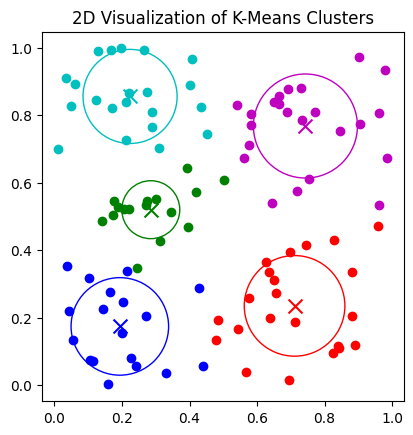

In [7]:
# Plotting the documents in a 2D space
import matplotlib

plt.figure(figsize=(8, 6))
fig, ax = plt.subplots()
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'orange', 'darkgreen', 'gray']

for i, document in enumerate(data):
    plt.scatter(document[0], document[1], c=colors[k_assigned_clusters[i]], label=f'Cluster {k_assigned_clusters[i]}')

for i, centroid in enumerate(k_centroids):    
    plt.scatter(centroid[0], centroid[1], c=colors[i], marker='x', s=100)
    avg_distance = np.mean([cluster.euclidean_distance(centroid[0] - v[0], centroid[1] - v[1]) for v in data[np.isin(k_assigned_clusters, [i])] ])
    circle =  matplotlib.patches.Circle((centroid[0], centroid[1]), avg_distance, edgecolor=colors[i], facecolor='none', linewidth=1)
    ax.add_patch(circle)
    ax.set_aspect('equal')

plt.title('2D Visualization of K-Means Clusters')
plt.show()

## EM Clustering
in NLTK EM doesn't seem to like clustering values in the range [0,1) so we multiply all the data by 10 to find the cluster.   It should not affect the results.

In [8]:
# using k-means centroids is a good option for initial means
em_initial_means =  k_centroids * 10

em_clusterer = cluster.EMClusterer(em_initial_means, bias=0.2)

em_assigned_clusters = em_clusterer.cluster(data * 10, True, trace=False)
print("Assigned Clusters:", em_assigned_clusters)


[ 0.47316313 -1.17836927] [[1. 0.]
 [0. 1.]]
[-0.4440162  -4.63553999] [[1. 0.]
 [0. 1.]]
[-4.7029082  -1.78669529] [[1. 0.]
 [0. 1.]]
[ 0.1700107  -7.99013302] [[1. 0.]
 [0. 1.]]
[-5.02393049 -7.11377645] [[1. 0.]
 [0. 1.]]
[ 3.7335603 -1.3539617] [[1. 0.]
 [0. 1.]]
[ 2.81638097 -4.81113242] [[1. 0.]
 [0. 1.]]
[-1.44251103 -1.96228772] [[1. 0.]
 [0. 1.]]
[ 3.43040787 -8.16572545] [[1. 0.]
 [0. 1.]]
[-1.76353332 -7.28936889] [[1. 0.]
 [0. 1.]]
[-0.213548    3.29911366] [[1. 0.]
 [0. 1.]]
[-1.13072733 -0.15805706] [[1. 0.]
 [0. 1.]]
[-5.38961933  2.69078764] [[1. 0.]
 [0. 1.]]
[-0.51670043 -3.51265009] [[1. 0.]
 [0. 1.]]
[-5.71064162 -2.63629352] [[1. 0.]
 [0. 1.]]
[3.45594813 6.56449393] [[1. 0.]
 [0. 1.]]
[2.53876879 3.10732321] [[1. 0.]
 [0. 1.]]
[-1.72012321  5.95616791] [[1. 0.]
 [0. 1.]]
[ 3.15279569 -0.24726983] [[1. 0.]
 [0. 1.]]
[-2.0411455   0.62908674] [[1. 0.]
 [0. 1.]]
[4.5778764  6.63423646] [[1. 0.]
 [0. 1.]]
[3.66069707 3.17706574] [[1. 0.]
 [0. 1.]]
[-0.59819493  6.0259

## Visualization of EM
Centroids of each cluster marked with an X

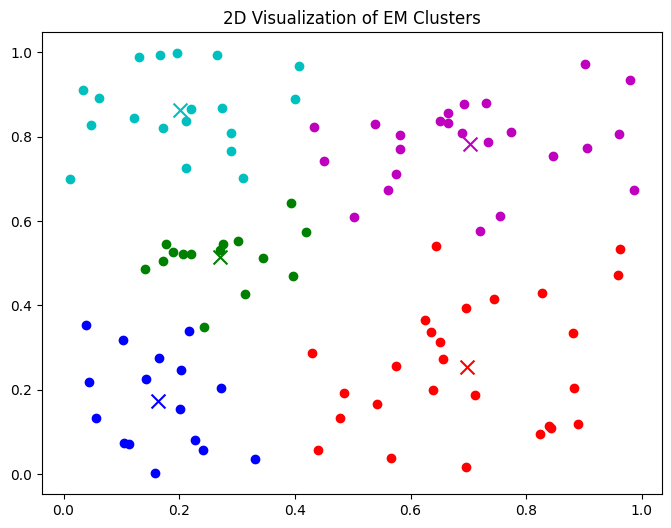

In [12]:
# Plotting the documents in a 2D space
plt.figure(figsize=(8, 6))
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'orange', 'darkgreen', 'gray']

for i, document in enumerate(data):
    plt.scatter(document[0], document[1], c=colors[em_assigned_clusters[i]], label=f'Cluster {em_assigned_clusters[i]}')
    

for i in range(NUM_CLUSTERS):
    centroid = np.mean(data[np.isin(em_assigned_clusters, [i])], axis=0)
    plt.scatter(centroid[0], centroid[1], c=colors[i], marker='x', s=100)


plt.title('2D Visualization of EM Clusters')
plt.show()

## GAAC Clusterer
NOTE: The GAAC Clusterer uses the cosine similarity **only** and so the clusters will extend from the origin in pie-like slices.

In [15]:
import matplotlib.pyplot as plt
from nltk import cluster

gaa_clusterer = cluster.GAAClusterer(NUM_CLUSTERS, normalise=False)
gaa_assigned_clusters = gaa_clusterer.cluster(data, assign_clusters=True)
print("Assigned Clusters:", gaa_assigned_clusters)



Assigned Clusters: [3, 3, 4, 0, 0, 4, 3, 4, 3, 4, 0, 1, 1, 2, 3, 3, 1, 4, 4, 1, 4, 4, 4, 1, 2, 0, 0, 3, 0, 0, 0, 4, 4, 4, 0, 2, 4, 4, 1, 0, 2, 0, 0, 0, 0, 4, 0, 4, 4, 2, 1, 4, 4, 0, 0, 2, 4, 4, 0, 0, 1, 3, 0, 4, 4, 3, 2, 2, 1, 0, 2, 1, 2, 0, 3, 0, 3, 0, 4, 0, 4, 3, 3, 4, 2, 0, 3, 2, 2, 1, 1, 4, 1, 0, 4, 2, 2, 3, 4, 1]


## Visualization

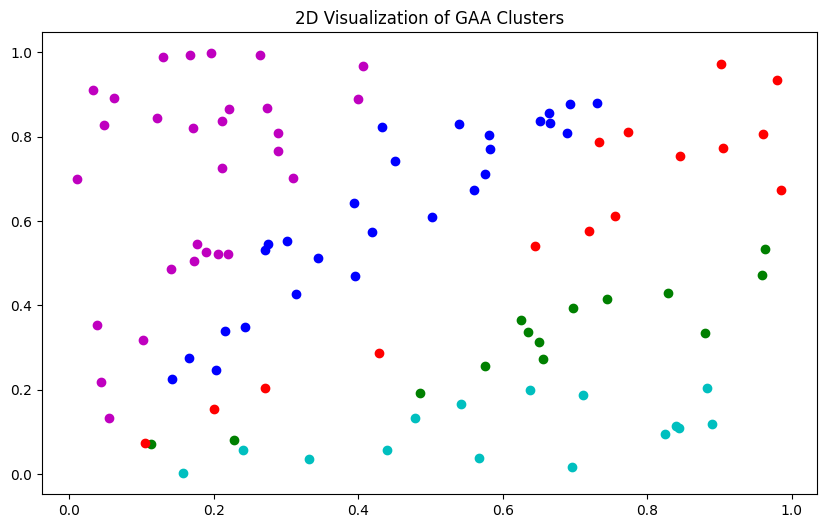

In [16]:
# Plotting the documents in a 2D space
plt.figure(figsize=(10, 6))
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'orange', 'darkgreen', 'gray']

for i, document in enumerate(data):
    plt.scatter(document[0], document[1], c=colors[gaa_assigned_clusters[i]], label=f'Cluster {gaa_assigned_clusters[i]}')

plt.title('2D Visualization of GAA Clusters')
plt.show()